In [1]:
import glob

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

from pylab import rcParams

from utils import METRICS, CONT_PARAMETERS, LOG_PARAMETERS, SET_PARAMETERS, INT_PARAMETERS, read_files,\
    top_mean_dev_auc, top_min_whole_validation_auc, top_min_dev_auc, read_files

In [2]:
rcParams['figure.figsize'] = 20, 5
pd.set_option('display.max_columns', None)

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
files = ['./experiments/wide-5fold-3seed.pkl']

In [5]:
top_k = 100000
min_iterations = 50

In [6]:
best_mean_dev = top_mean_dev_auc(read_files(files), top_k)\
    .pipe(lambda x: x[x.groupby(['file', 'experiment_id']).iteration.transform('size') > min_iterations])
best_mean_dev.groupby(['file', 'experiment_id']).ngroups

217

In [7]:
best_min_dev = top_min_dev_auc(read_files(files), top_k)\
    .pipe(lambda x: x[x.groupby(['file', 'experiment_id']).iteration.transform('size') > min_iterations])
best_min_dev.groupby(['file', 'experiment_id']).ngroups

217

In [8]:
true_best = top_min_whole_validation_auc(read_files(files), top_k)\
    .pipe(lambda x: x[x.groupby(['file', 'experiment_id']).iteration.transform('size') > min_iterations])
true_best.groupby(['file', 'experiment_id']).ngroups

222

In [9]:
compare_columns = ['mean_dev_auc', 'mean_validation_auc',
               'mean_whole_validation_auc', 'min_dev_auc', 'min_validation_auc', 'min_whole_validation_auc']

In [10]:
best_mean_dev[compare_columns].describe().T

,count,mean,std,min,25%,50%,75%,max
mean_dev_auc,99956.0,0.808998,0.010864,0.793695,0.800448,0.806575,0.818519,0.832747
mean_validation_auc,99956.0,0.790008,0.010628,0.764389,0.782081,0.789447,0.799034,0.812787
mean_whole_validation_auc,99956.0,0.790740,0.010779,0.678407,0.783141,0.790266,0.799313,0.813447
min_dev_auc,99956.0,0.795698,0.012026,0.718409,0.787092,0.793804,0.805685,0.823482
min_validation_auc,99956.0,0.785403,0.012196,0.697640,0.777042,0.784434,0.795567,0.809468
min_whole_validation_auc,99956.0,0.788368,0.014706,0.453379,0.781258,0.788519,0.797472,0.812311


In [11]:
best_mean_dev.min_whole_validation_auc.corr(best_mean_dev.mean_dev_auc, method='spearman')

0.8628352024671244

In [12]:
best_mean_dev.mean_whole_validation_auc.corr(best_mean_dev.mean_dev_auc, method='spearman')

0.8949419930790867

In [13]:
best_min_dev[compare_columns].describe().T

,count,mean,std,min,25%,50%,75%,max
mean_dev_auc,99957.0,0.808783,0.011130,0.786920,0.800370,0.806570,0.818519,0.832747
mean_validation_auc,99957.0,0.789827,0.010872,0.764349,0.781854,0.789596,0.799034,0.812787
mean_whole_validation_auc,99957.0,0.790721,0.010851,0.678407,0.783141,0.790430,0.799313,0.813447
min_dev_auc,99957.0,0.796115,0.011164,0.778327,0.787092,0.793803,0.805685,0.823482
min_validation_auc,99957.0,0.785759,0.011497,0.747370,0.777092,0.784444,0.795567,0.809468
min_whole_validation_auc,99957.0,0.788627,0.014116,0.453379,0.781258,0.788822,0.797472,0.812311


In [14]:
best_min_dev.min_whole_validation_auc.corr(best_min_dev.min_dev_auc, method='spearman')

0.8131083074627902

In [15]:
best_min_dev.min_whole_validation_auc.corr(best_min_dev.mean_dev_auc, method='spearman')

0.8481452029249787

In [16]:
true_best[compare_columns].describe().T

,count,mean,std,min,25%,50%,75%,max
mean_dev_auc,99901.0,0.790832,0.066538,0.500000,0.798558,0.806478,0.818519,0.832747
mean_validation_auc,99901.0,0.773597,0.062589,0.500000,0.781076,0.789679,0.799034,0.812787
mean_whole_validation_auc,99901.0,0.794388,0.008364,0.779528,0.787799,0.792900,0.801839,0.813447
min_dev_auc,99901.0,0.772982,0.076487,0.435650,0.783990,0.793747,0.805596,0.823482
min_validation_auc,99901.0,0.764125,0.074812,0.400430,0.775900,0.784633,0.795575,0.809468
min_whole_validation_auc,99901.0,0.792894,0.008535,0.779364,0.785816,0.791546,0.800656,0.812311


In [17]:
true_best.min_whole_validation_auc.corr(true_best.min_dev_auc, method='spearman')

0.46663572325043345

In [18]:
true_best.min_whole_validation_auc.corr(true_best.mean_dev_auc, method='spearman')

0.48794368638766883

In [19]:
true_best.mean_whole_validation_auc.corr(true_best.min_dev_auc, method='spearman')

0.48092319694322966

In [20]:
true_best.mean_whole_validation_auc.corr(true_best.mean_dev_auc, method='spearman')

0.5106333702747787

In [21]:
best_mean_dev.merge(true_best, on=['file', 'experiment_id', 'iteration'])\
    .groupby(['file', 'experiment_id']).ngroups

178

In [22]:
best_mean_dev.merge(true_best, on=['file', 'experiment_id', 'iteration']).shape

(79727, 119)

In [23]:
best_min_dev.merge(true_best, on=['file', 'experiment_id', 'iteration'])\
    .groupby(['file', 'experiment_id']).ngroups

179

In [24]:
best_min_dev.merge(true_best, on=['file', 'experiment_id', 'iteration']).shape

(79629, 119)

In [25]:
best = best_mean_dev

In [26]:
best.shape

(99956, 61)

In [27]:
best.groupby(SET_PARAMETERS).min_whole_validation_auc.describe()

count      mean       std  \
param_is_unbalance param_boost_from_average                                
False              False                     17617.0  0.783044  0.024532   
                   True                      13516.0  0.788591  0.009634   
True               False                     39519.0  0.790149  0.011230   
                   True                      29304.0  0.789064  0.011885   

                                                  min       25%       50%  \
param_is_unbalance param_boost_from_average                                 
False              False                     0.453379  0.778540  0.784899   
                   True                      0.729957  0.781808  0.786760   
True               False                     0.710797  0.782678  0.790199   
                   True                      0.738916  0.781072  0.789597   

                                                  75%       max  
param_is_unbalance param_boost_from_average                      
False              False                     0.791171  0.812311  
                   True                      0.795418  0.812156  
True               False                     0.800829  0.809881  
                   True                      0.797243  0.811695

In [28]:
best.groupby(SET_PARAMETERS + ['file', 'experiment_id']).size().groupby(SET_PARAMETERS).size()

param_is_unbalance  param_boost_from_average
False               False                       40
                    True                        30
True                False                       85
                    True                        62
dtype: int64

In [29]:
best['param_bagging_enable'] = (best.param_bagging_freq != 0)

best.groupby('param_bagging_enable').size()

param_bagging_enable
False    68047
True     31909
dtype: int64

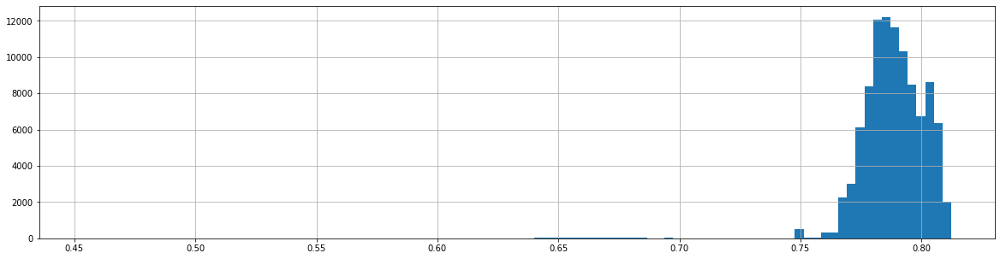

In [30]:
best.min_whole_validation_auc.hist(bins=100);

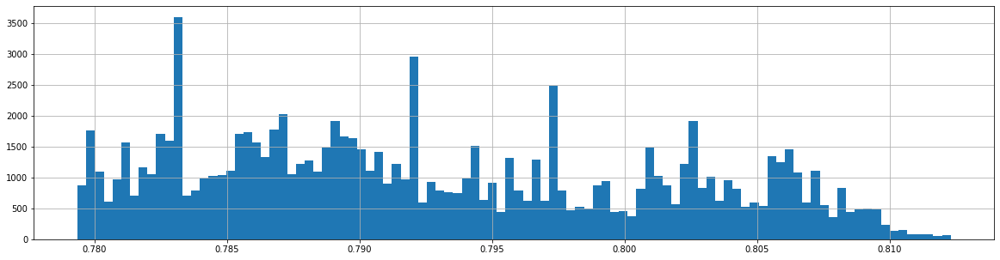

In [31]:
true_best.min_whole_validation_auc.hist(bins=100);

In [32]:
best_iteration = best.sort_values('mean_dev_auc').groupby(['file', 'experiment_id']).last()

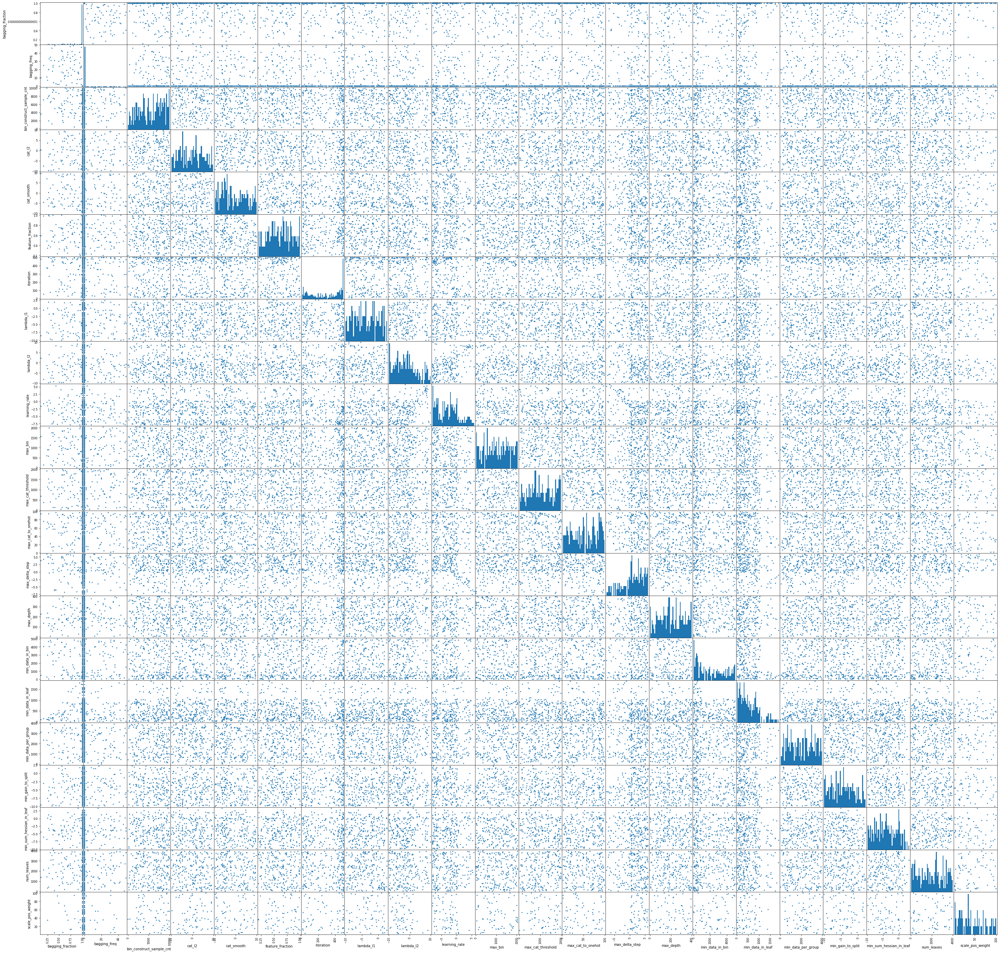

In [46]:
pd.plotting.scatter_matrix(
    pd.concat([best_iteration[CONT_PARAMETERS + INT_PARAMETERS], 
               np.log10(best_iteration[list(set(LOG_PARAMETERS))])],
              axis='columns',
              sort=True
             ).rename(lambda x: x.replace('param_', ''), axis='columns').sort_index(axis=1),
    alpha=1, figsize=(50, 50), hist_kwds={'bins': 50});

### check failures in best selected parameter range

In [34]:
best_range = best\
    [[c for c in best.columns if c.startswith('param_') and not c in SET_PARAMETERS]]\
    .drop(columns=['param_seed', 'param_bagging_enable'])\
    .quantile([0, 1]).T
best_range

,0.0,1.0
param_bagging_fraction,1.107804e-01,1.000000e+00
param_bagging_freq,0.000000e+00,4.900000e+01
param_bin_construct_sample_cnt,5.300000e+01,9.990000e+03
param_cat_l2,1.454478e-10,5.800938e+09
param_cat_smooth,1.045909e-10,8.183562e+09
param_feature_fraction,2.006477e-01,9.971879e-01
param_lambda_l1,1.028902e-10,3.782759e+02
param_lambda_l2,1.483806e-10,9.694718e+09
param_learning_rate,1.024252e-08,5.453911e+05
param_max_bin,1.000000e+01,2.037000e+03


In [35]:
dfs = []
for f in files:
    df = pd.read_pickle(f).assign(file=f)
    for (n, l, h) in best_range.itertuples():
        df = df[(((df[n] >= l) & (df[n] <= h))
                 | df[n].isna())].copy()
    dfs.append(df)

limited = pd.concat(dfs, ignore_index=True, sort=True)
del dfs
limited.shape

(985000, 61)

In [36]:
limited_best_iteration = limited.sort_values('min_whole_validation_auc').groupby(['file', 'experiment_id']).last()
limited_best_iteration.shape

(1970, 59)

In [37]:
limited_best_iteration['param_bagging_enable'] = (limited_best_iteration.param_bagging_freq != 0)

In [38]:
limited_best_iteration.min_whole_validation_auc.describe()

count    1970.000000
mean        0.598387
std         0.118263
min         0.493961
25%         0.500000
50%         0.500000
75%         0.720536
max         0.812311
Name: min_whole_validation_auc, dtype: float64

In [39]:
limited_bad = limited_best_iteration[limited_best_iteration.min_whole_validation_auc < 0.6]

In [40]:
limited_bad.shape

(1129, 60)

TODO pikachu with bruises reaction

In [41]:
limited_bad.groupby(SET_PARAMETERS).size()

param_is_unbalance  param_boost_from_average
False               False                       345
                    True                        379
True                False                       177
                    True                        228
dtype: int64

In [42]:
limited_bad.groupby('param_bagging_enable').size()

param_bagging_enable
False    483
True     646
dtype: int64

In [43]:
limited_best_iteration.groupby(SET_PARAMETERS).min_whole_validation_auc.describe()

count      mean       std  \
param_is_unbalance param_boost_from_average                              
False              False                     490.0  0.566715  0.105808   
                   True                      486.0  0.550513  0.098389   
True               False                     511.0  0.660740  0.120754   
                   True                      483.0  0.612722  0.113792   

                                                  min  25%       50%  \
param_is_unbalance param_boost_from_average                            
False              False                     0.493961  0.5  0.500000   
                   True                      0.500000  0.5  0.500000   
True               False                     0.500000  0.5  0.710368   
                   True                      0.500000  0.5  0.642804   

                                                  75%       max  
param_is_unbalance param_boost_from_average                      
False              False                     0.649691  0.812311  
                   True                      0.500000  0.812156  
True               False                     0.766617  0.809881  
                   True                      0.706934  0.811695

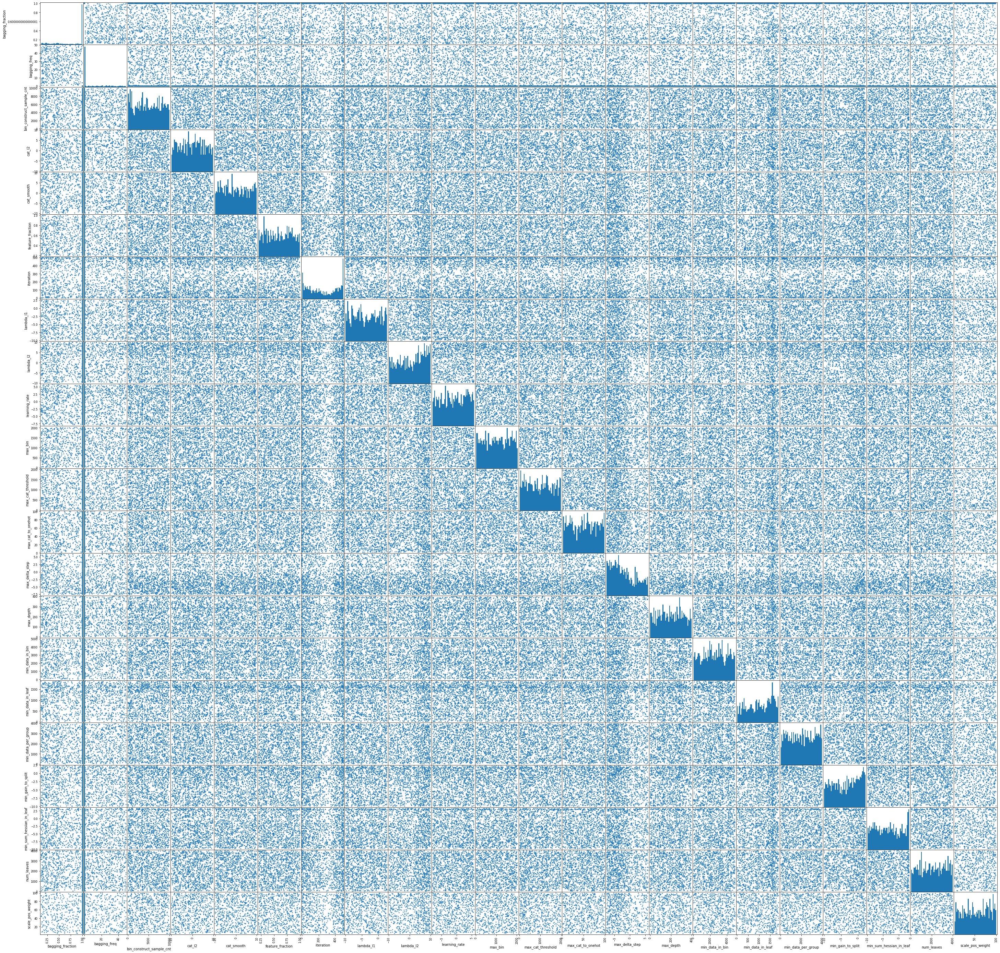

In [47]:
pd.plotting.scatter_matrix(
    pd.concat([limited_bad[CONT_PARAMETERS + INT_PARAMETERS], 
               np.log10(limited_bad[list(set(LOG_PARAMETERS))])],
              axis='columns',
              sort=True
             ).rename(lambda x: x.replace('param_', ''), axis='columns').sort_index(axis=1),
    alpha=0.8, figsize=(50, 50), hist_kwds={'bins': 50});

### top parameters

In [45]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    print(best_iteration.sort_values('mean_dev_auc', ascending=False).head().T)

file                                 ./experiments/wide-5fold-3seed.pkl  \
experiment_id                                                      3301   
cnt                                                                   3   
iteration                                                           216   
max_dev_auc                                                    0.854963   
max_dev_binary_logloss                                         0.501748   
max_overfit_auc                                                 0.02247   
max_overfit_binary_logloss                                    0.0108829   
max_validation_auc                                             0.808964   
max_validation_binary_logloss                                  0.521344   
max_whole_train_auc                                            0.843042   
max_whole_train_binary_logloss                                 0.480187   
max_whole_validation_auc                                       0.805902   
max_whole_validation_bina